<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Read-and-map-a-landsat-band-1-image" data-toc-modified-id="Read-and-map-a-landsat-band-1-image-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Read and map a landsat band 1 image</a></span><ul class="toc-item"><li><span><a href="#use-a-B1.TIF,-T1.jpg-and-MTL.txt-file-from-the-download" data-toc-modified-id="use-a-B1.TIF,-T1.jpg-and-MTL.txt-file-from-the-download-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>use a B1.TIF, T1.jpg and MTL.txt file from the download</a></span></li><li><span><a href="#Installs-needed" data-toc-modified-id="Installs-needed-1.2"><span class="toc-item-num">1.2&nbsp;&nbsp;</span>Installs needed</a></span><ul class="toc-item"><li><span><a href="#For-windows,-install--the-tar-program" data-toc-modified-id="For-windows,-install--the-tar-program-1.2.1"><span class="toc-item-num">1.2.1&nbsp;&nbsp;</span>For windows, install  the tar program</a></span></li><li><span><a href="#To-extract-files-from-a-compressed-tar.gz-archive" data-toc-modified-id="To-extract-files-from-a-compressed-tar.gz-archive-1.2.2"><span class="toc-item-num">1.2.2&nbsp;&nbsp;</span>To extract files from a compressed tar.gz archive</a></span></li></ul></li></ul></li><li><span><a href="#Band-1-read-into-a-numpy-array-named-ch1" data-toc-modified-id="Band-1-read-into-a-numpy-array-named-ch1-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Band 1 read into a numpy array named ch1</a></span></li><li><span><a href="#Here-is-the-tiff-file-metadata" data-toc-modified-id="Here-is-the-tiff-file-metadata-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Here is the tiff file metadata</a></span></li><li><span><a href="#Here-is-the-landsat-MTL.txt-metadata" data-toc-modified-id="Here-is-the-landsat-MTL.txt-metadata-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Here is the landsat MTL.txt metadata</a></span></li><li><span><a href="#Use-the-jpeg-image-for-orientation" data-toc-modified-id="Use-the-jpeg-image-for-orientation-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Use the jpeg image for orientation</a></span></li><li><span><a href="#Here-is-the-raw-band-1" data-toc-modified-id="Here-is-the-raw-band-1-6"><span class="toc-item-num">6&nbsp;&nbsp;</span>Here is the raw band 1</a></span></li><li><span><a href="#Get-extent-from-MTL-file" data-toc-modified-id="Get-extent-from-MTL-file-7"><span class="toc-item-num">7&nbsp;&nbsp;</span>Get extent from MTL file</a></span></li><li><span><a href="#Make-a-map-with-the-image" data-toc-modified-id="Make-a-map-with-the-image-8"><span class="toc-item-num">8&nbsp;&nbsp;</span>Make a map with the image</a></span></li></ul></div>

# Read and map a landsat band 1 image

## use a B1.TIF, T1.jpg and MTL.txt file from the download

## Installs needed

###  For windows, install  the tar program
   
     conda install -c msys2 m2-tar
     
###  To extract files from a compressed tar.gz archive

* list files with

      tar tzvf filename.tar.gz
  
  extract files with

      tar xzvf filename.tar.gz
      
* Install the python imaging library

       conda install -c conda-forge pillow
     

In [1]:
import a301
from pathlib import Path
#import rasterio
from IPython.display import Image
from a301.landsat.landsat_metadata import landsat_metadata
from PIL import Image as pil_image
from PIL.TiffTags import TAGS
import numpy as np

may_2015=a301.test_dir / Path("landsat_2018_05_13")
tiff_file=list(may_2015.glob("*B1.TIF"))[0]
meta_file=list(may_2015.glob("*MTL.txt"))[0]
jpeg_file=list(may_2015.glob("*T1.jpg"))[0]

In [2]:
with pil_image.open(tiff_file) as img:
    tiff_meta_dict = {TAGS[key] : img.tag[key] for key in img.tag.keys()}
    ch1=np.array(img)

# Band 1 read into a numpy array named ch1

In [3]:
ch1.dtype, ch1.shape

(dtype('uint8'), (7381, 8311))

# Here is the tiff file metadata

In [4]:
tiff_keys=list(tiff_meta_dict.keys())
tiff_keys
#tiff_meta_dict['GeoAsciiParamsTag']

['ImageWidth',
 'ImageLength',
 'BitsPerSample',
 'Compression',
 'ModelTiepointTag',
 'PhotometricInterpretation',
 'ModelPixelScaleTag',
 'GeoKeyDirectoryTag',
 'StripOffsets',
 'GeoAsciiParamsTag',
 'SampleFormat',
 'SamplesPerPixel',
 'RowsPerStrip',
 'StripByteCounts',
 'PlanarConfiguration']

# Here is the landsat MTL.txt metadata

In [5]:
#raster = rasterio.open(tiff_file)
out=landsat_metadata(meta_file)
meta_dict = out.__dict__
print(meta_dict['SPACECRAFT_ID'])
list(meta_dict.keys())

Scene LE70470262018133EDC00 center time is 2018-05-13 19:01:40
LANDSAT_7


['FILEPATH',
 'DATETIME_OBJ',
 'LANDSAT_SCENE_ID',
 'DATA_TYPE',
 'ELEVATION_SOURCE',
 'OUTPUT_FORMAT',
 'SPACECRAFT_ID',
 'SENSOR_ID',
 'WRS_PATH',
 'WRS_ROW',
 'NADIR_OFFNADIR',
 'TARGET_WRS_PATH',
 'TARGET_WRS_ROW',
 'DATE_ACQUIRED',
 'SCENE_CENTER_TIME',
 'CLOUD_COVER',
 'IMAGE_QUALITY_OLI',
 'IMAGE_QUALITY_TIRS',
 'ROLL_ANGLE',
 'SUN_AZIMUTH',
 'SUN_ELEVATION',
 'EARTH_SUN_DISTANCE',
 'ORIGIN',
 'REQUEST_ID',
 'LANDSAT_PRODUCT_ID',
 'COLLECTION_NUMBER',
 'FILE_DATE',
 'STATION_ID',
 'PROCESSING_SOFTWARE_VERSION',
 'DATA_CATEGORY',
 'COLLECTION_CATEGORY',
 'EPHEMERIS_TYPE',
 'SENSOR_MODE',
 'CORNER_UL_LAT_PRODUCT',
 'CORNER_UL_LON_PRODUCT',
 'CORNER_UR_LAT_PRODUCT',
 'CORNER_UR_LON_PRODUCT',
 'CORNER_LL_LAT_PRODUCT',
 'CORNER_LL_LON_PRODUCT',
 'CORNER_LR_LAT_PRODUCT',
 'CORNER_LR_LON_PRODUCT',
 'CORNER_UL_PROJECTION_X_PRODUCT',
 'CORNER_UL_PROJECTION_Y_PRODUCT',
 'CORNER_UR_PROJECTION_X_PRODUCT',
 'CORNER_UR_PROJECTION_Y_PRODUCT',
 'CORNER_LL_PROJECTION_X_PRODUCT',
 'CORNER_LL_PROJ

# Use the jpeg image for orientation

In [6]:
from IPython.display import Image
Image(filename=str(jpeg_file),width=400)

# Here is the raw band 1

In [7]:
im = pil_image.open(tiff_file)
im

# Get extent from MTL file

In [8]:
meta_dict['CORNER_UL_PROJECTION_X_PRODUCT']
xmin=meta_dict['CORNER_UL_PROJECTION_X_PRODUCT']
xmax=meta_dict['CORNER_UR_PROJECTION_X_PRODUCT']
ymax=meta_dict['CORNER_LL_PROJECTION_Y_PRODUCT']
ymin=meta_dict['CORNER_UL_PROJECTION_Y_PRODUCT']

# Make a map with the image

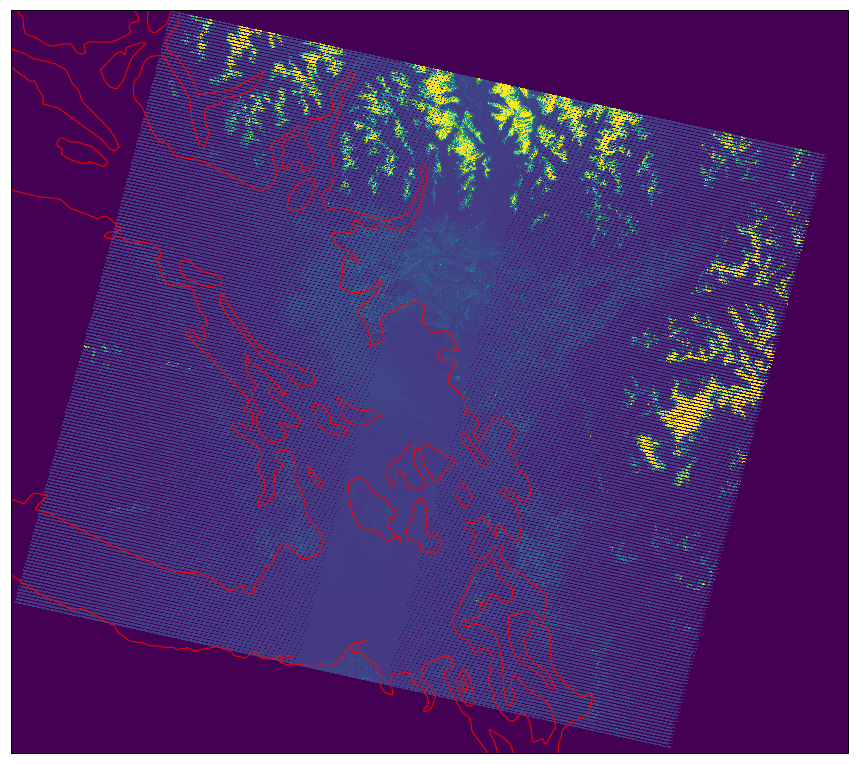

In [13]:
%matplotlib inline
from matplotlib import pyplot as plt
import cartopy
zone=meta_dict['UTM_ZONE']
zone_code = 32610
#https://epsg.io/32610
crs = cartopy.crs.epsg(zone_code)
fig, ax = plt.subplots(1, 1,figsize=[15,15],subplot_kw={'projection': crs})
ax.imshow(ch1, origin='lower', extent=[xmin, xmax, ymin, ymax], transform=crs, 
          interpolation='nearest')
ax.coastlines(resolution='10m',color='red',lw=1)
ax.set_extent([xmin,xmax,ymin,ymax],crs)